# <a href="https://miptstats.gitlhub.io/courses/ad_fivt.html">Введение в анализ данных</a>
## Домашнее задание 7. Кластеризация и понижение размерности

При необходимости установите библиотеку-расширение для `plotly`, позволяющую рисовать картинки на всплывающих окнах.

    pip install dash

In [1]:
!pip install dash

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 30.7 MB/s eta 0:00:0000:010:01


In [2]:
import io
import os
import base64
import random

import numpy as np
import pandas as pd
from tqdm.cli import tqdm

import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import plotly.express as px
import plotly
from dash import Dash, dcc, html, Input, Output, no_update, callback

from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import torch
from transformers import ViTImageProcessor, ViTModel

sns.set_theme(style="darkgrid", palette="Set2")

2024-04-13 11:48:42.156866: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-13 11:48:42.156980: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-13 11:48:42.258455: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


<font size="4"><b>Внимание! Файл с решением может быть тяжелым. Если он весит 20 Мб и более, заранее разделите его на несколько частей.</b></font>

---
### Задача 1. 

Докажите, что метод KMeans делит все пространство объектов на выпуклые многоугольники, возможно, неограниченные.

K-means соотносит каждый элемент в пространствве признаков к ближайшему центру кластера. Рассмотрим тогда два произвольных центра кластера. Геометрическое место точек, равноудаленных от двух цетров - это серединный перпендикуляр к соединяющему их отрезку. Следовательно, все точки по одну сторону сер. пера принадлежат к одном уцентру, по другую - ко второму. Продолжая аналогично с первым центром для всех остальных, получим, что можно отделить его от всех других кластеров, так как пересечение полупространств выпукло. То есть прродолжая ту же процедулу для всех кластеров со всеми, получаем, что все кластеры выпуклые.

---
### Задача 2. 

Как мы знаем из лекции, в пространствах большой размерности расстояния между случайными объектами становятся неинформативными. Эта проблема известна как *проклятие размерности*, и она влечет соответствующие ограничения на использование методов, основанных на использовании расстоянии между объектами.

В этой задаче предлагается промоделировать ситуацию понижения размерности. Сгенерируйте достаточно большое количество точек в единичном кубе в пространстве некоторой размерности. Пример кода дан ниже

In [23]:
sample_size = 1000
dimention = 100
sample = np.random.uniform(size=(sample_size, dimention))

Повторите генерацию для нескольких размерностей пространства от 2 до 1000. Используйте не менее 7 различных значений размерностей пространства.

In [37]:
samples = dict()
for dim in np.array([2, 3, 4, 10, 100, 300, 600, 900]):
    samples[dim] = np.random.uniform(size=(sample_size, dim))

Для каждой размерности посчитайте норму каждой точки, тем самым получая набор значений расстояния от 0 до случайной точки. Нормируйте все расстояния, поделив на среднее полученных расстояний для каждой размерности пространства.

In [38]:
norms = dict()
for i in samples.keys():
    norms[i] = np.linalg.norm(samples[i], axis=1)
    norms[i] /= np.mean(norms[i])

Нарисуйте на одном графике KDE-оценки плотности нормированных расстояний для каждой размерности пространства.

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

  with pd.option_context('mode.use_inf_as_na', True):

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

  with pd.option_context('mode.use_inf_as_na', True):

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

  with pd.option_context('mode.use_inf_as_na', True):

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating inste

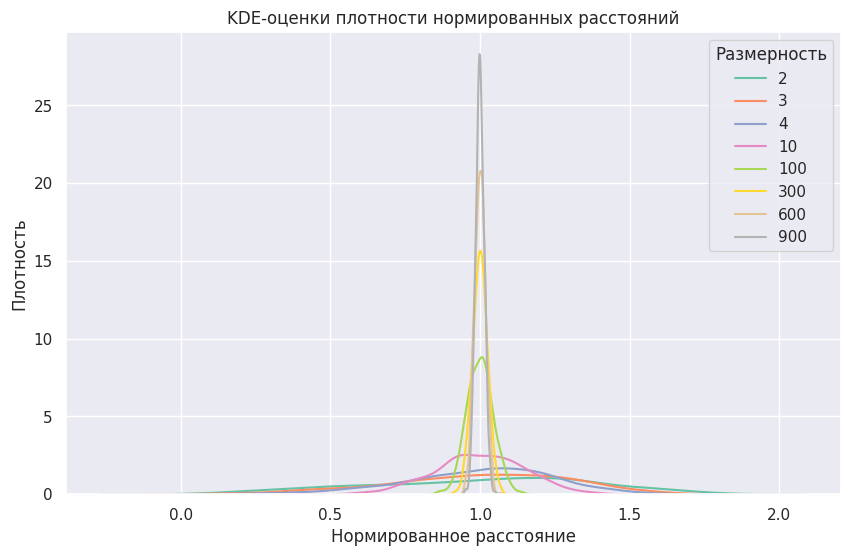

In [39]:
plt.figure(figsize=(10, 6))
for dim in samples.keys():
    sns.kdeplot(norms[dim], label=dim)

plt.title("KDE-оценки плотности нормированных расстояний")
plt.xlabel("Нормированное расстояние")
plt.ylabel("Плотность")
plt.legend(title="Размерность")
plt.show()

**Вывод.** Итак, данный эксперимент (в частности, график) показывает, что с ростом размерности пространства расстояния перестают нести важную информацию, так как начинают сосредотачиваться около одного значения. Это значит, что нужно бороться с большими размерностями для пространств, в которых мы собираемся работать.

---
### Задача 3.

В этой задаче мы попробуем кластеризовать различными способами изображения котиков из датасета с семинара.

Скачайте данные, загрузите их и отрисуйте несколько примеров.

Размерность cats: (9303, 12288)


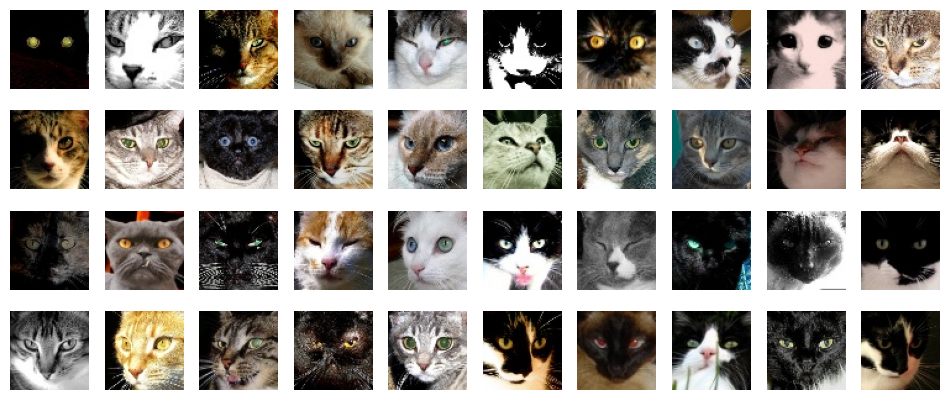

In [3]:
# Загружаем картинки
cats_path = "/kaggle/input/cats-dataset/cats"
# cats_path = "cats"
cats = []

for filename in os.listdir(cats_path):
    cats.append(plt.imread(os.path.join(cats_path, filename)))

cats = np.unique(np.stack(cats).reshape(-1, 64 * 64 * 3), axis=0)
print(f"Размерность cats: {cats.shape}")


# Визуализируем примеры
plt.figure(figsize=(12, 5))
for i in range(40):
    plt.subplot(4, 10, i + 1)
    plt.imshow(cats[i].reshape(64, 64, 3))
    plt.axis("off")

#### 1. Свойства метрики в пространстве котиков

Прежде всего давайте исследуем, наблюдается ли проблема проклятия размерности в пространстве котиков, фактически повторив исследование предыдущей задачи. Для этого выберите не менее 10000 случайных пар изображений и посчитайте расстояния между ними. Визуализируйте KDE-оценку плотности нормированных расстояний.

In [98]:
left = np.array([random.sample(range(len(cats)), k=10000)])[0]
right = np.array([random.sample(range(len(cats)), k=10000)])[0]

dists = np.linalg.norm(cats[left] - cats[right], axis=1)
dists /= np.mean(dists)
dists.shape

(10000,)

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

  with pd.option_context('mode.use_inf_as_na', True):


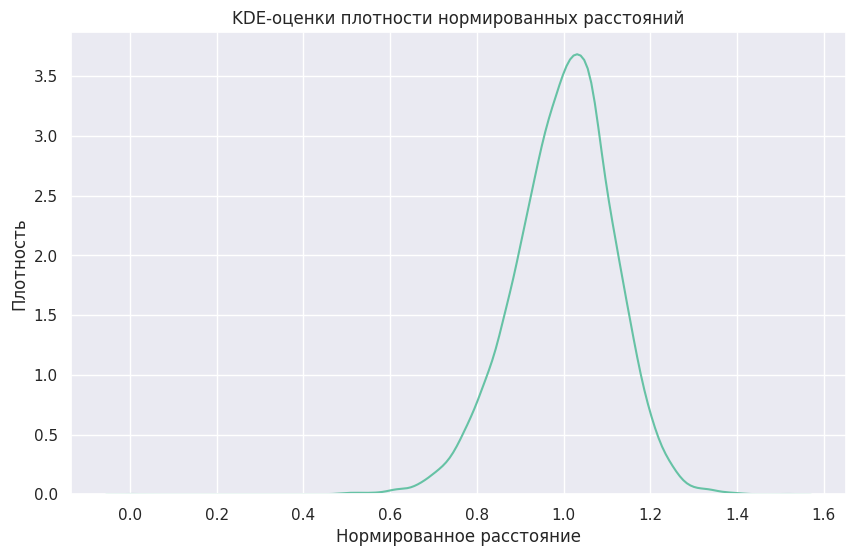

In [99]:
# Визуализируем KDE-оценку плотности нормированных расстояний.
plt.figure(figsize=(10, 6))
sns.kdeplot(dists)

plt.title("KDE-оценки плотности нормированных расстояний")
plt.xlabel("Нормированное расстояние")
plt.ylabel("Плотность")
plt.show()


Повторите те же действия к результату применения PCA, рассмотрев разное количество компонент, например, для 30, 100 и 500. Обратите внимание, что PCA нужно обучать на всех изображениях, а не только для тех, для которых вы будете считать расстояния.

In [104]:
pca = dict()
cats_projection = dict()
distances = dict()

for n in [30, 100, 500]:
    pca[n] = PCA(n)
    cats_projection[n] = pca[n].fit_transform(cats.astype(np.float32))
    
    l = np.array([random.sample(range(len(cats_projection[n])), k=10000)])[0]
    r = np.array([random.sample(range(len(cats_projection[n])), k=10000)])[0]

    distances[n] = np.linalg.norm(cats_projection[n][l] - cats_projection[n][r], axis=1)
    distances[n] /= np.mean(distances[n])

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

  with pd.option_context('mode.use_inf_as_na', True):

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

  with pd.option_context('mode.use_inf_as_na', True):

/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

  with pd.option_context('mode.use_inf_as_na', True):


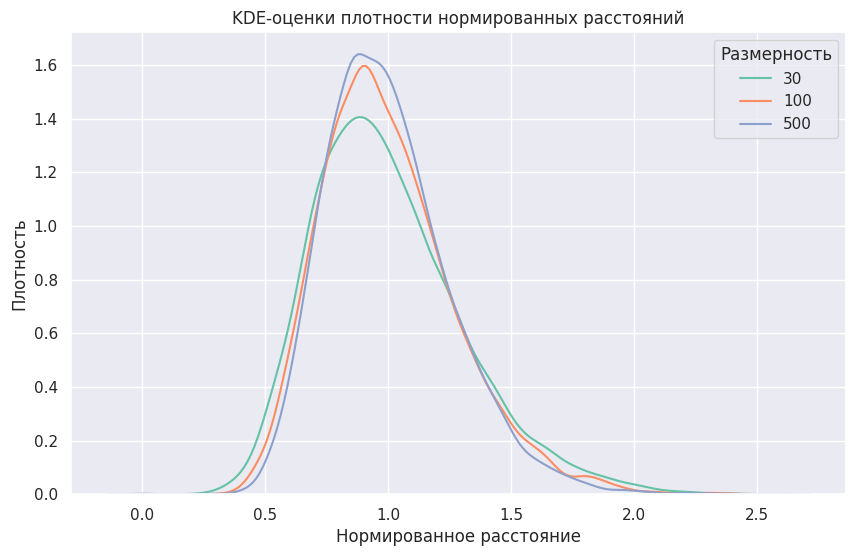

In [106]:
plt.figure(figsize=(10, 6))
for dim in distances.keys():
    sns.kdeplot(distances[dim], label=dim)

plt.title("KDE-оценки плотности нормированных расстояний")
plt.xlabel("Нормированное расстояние")
plt.ylabel("Плотность")
plt.legend(title="Размерность")
plt.show()

**Bывод.** Как видно из графиков (важно учесть, что они в разных масштабах), проблема проклятия размерности наблюдается и в пространстве котиков (пусть и менее выраженно). Но при применении PCA для понижения размерности, эта проблема неплохо решается.

#### 2. Кластеризация котиков по вектору изображения

Начнем эксперименты с самого простого способа: каждое изображение можно вытянуть в вектор размерности $64 \cdot 64 \cdot 3$, их и попытаемся кластеризовать. Обучите по этим объектам метод KMeans.

In [107]:
%%time


kmeans = KMeans(n_clusters=6, n_init="auto", random_state=42)
kmeans.fit(cats)

CPU times: user 36 s, sys: 694 ms, total: 36.7 s
Wall time: 10.3 s


KMeans(n_clusters=6, n_init='auto', random_state=42)

Теперь отобразим изображения на плоскость с помощью PCA и визуализируем полученные предсказания цветом, как это было сделано на семинаре для ответов на вопросы в бот. Ниже уже реализована функция отрисовки `visualize_images_clusterisation`, вам требуется лишь применить PCA и вызвать функцию с правильными параметрами.

In [4]:
def visualize_images_clusterisation(images, projection, clusters, port=None, use_dash=False):
    '''
    Визуализиует двумерную проекцию эмбеддингов изображений, 
    во всплывающем окне показывает сами изображения
 
    :param images: набор изображений
    :param projection: двумерная проекция изображений или эмбеддингов изображений
    :param clusters: предсказанные кластера
    :param port: опциональный параметр, порт на котором поднимается визуализация: 
                 одинаковые порты - одинаковые графики, но если в ноутбуке открыто много портов, то могут начаться лаги
    :param use_dash: если True, то рисуются картинки, но не сохраняется интерактивный график, 
                     если False, то наоборот график в ноутбуке сохранится, но картинок не будет
    '''
    plotly.offline.init_notebook_mode()
 
    # Рисуем график с точками как на семинаре
    fig = px.scatter(
        x=projection[:, 0], y=projection[:, 1], 
        hover_name=clusters, 
        hover_data={'image_idx': list(range(len(images)))},
        color=clusters.astype(str),
        width=1000, height=800,
        title='PCA проекция изображений на плоскость',
        size=[1] * len(images),
        size_max=12,
    )
    
    if not use_dash:
        fig.show()
        return
 
    # Добавляем во всплывающее окошко (hover box) изображения
    fig.update_traces(
        hoverinfo="none",
        hovertemplate=None,
    )
 
    app = Dash(__name__)
 
    app.layout = html.Div(
        className="container",
        children=[
            dcc.Graph(id="graph-2-dcc", figure=fig, clear_on_unhover=True),
            dcc.Tooltip(id="graph-tooltip-2", direction='bottom'),
        ],
    )
 
    @callback(
        Output("graph-tooltip-2", "show"),
        Output("graph-tooltip-2", "bbox"),
        Output("graph-tooltip-2", "children"),
        Output("graph-tooltip-2", "direction"),
 
        Input("graph-2-dcc", "hoverData"),
    )
    def display_hover(hoverData):
        '''
        Настраивает всплывающее окно hover box.
 
        :param hoverData: данные соответствующей точки
        '''
        if hoverData is None:
            return False, no_update, no_update, no_update
 
        # Достаем индекс картинки, который выше положили в hover_data
        hover_data = hoverData["points"][0]
        image_idx = hover_data['customdata'][0]
        # И получаем само изображение кота
        image = Image.fromarray(images[image_idx].reshape(64, 64, 3))
 
        # Преобразовываем изображение в base64 кодировку
        buffer = io.BytesIO()
        image.save(buffer, format="jpeg")
        encoded_image = base64.b64encode(buffer.getvalue()).decode()
        image_url = "data:image/jpeg;base64, " + encoded_image
 
        image_children = [
            html.Img(
                src=image_url,
                style={"width": "196px"},
            ),
        ]
 
        return True, hover_data["bbox"], image_children, 'top'
 
    if port is None:
        port = str(np.random.randint(5000, 15000))
    app.run(port=port, debug=True, jupyter_height=800)
 
    return app

/opt/conda/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



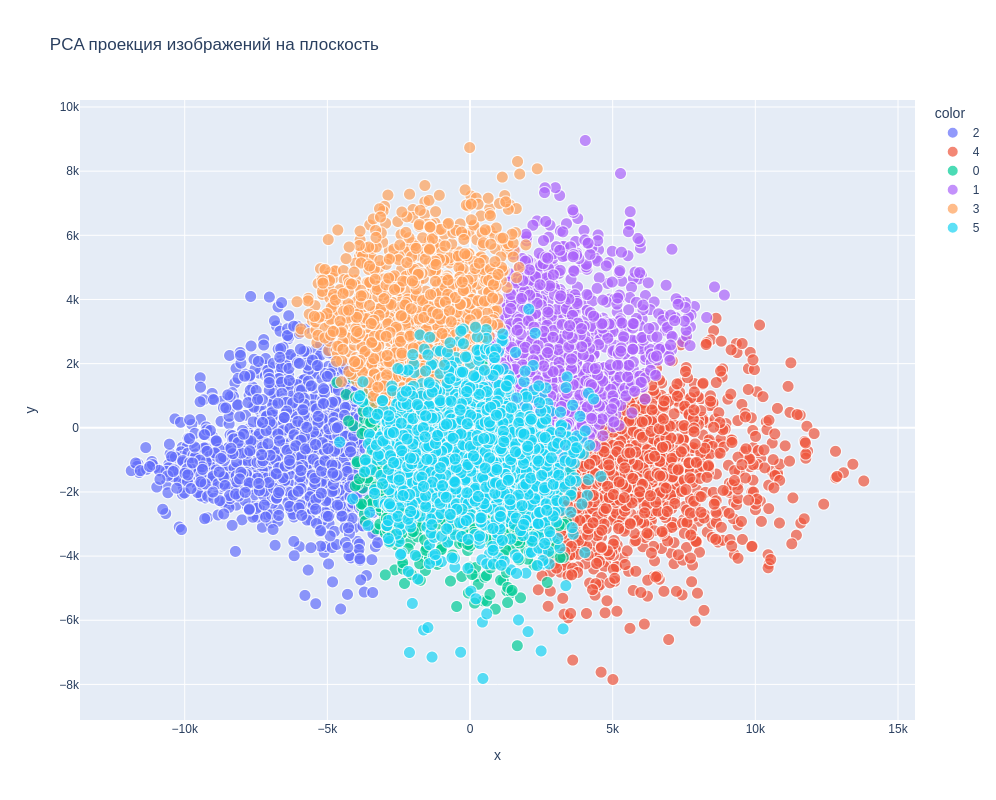

In [109]:
kmeans_pred = kmeans.predict(cats)
pca = PCA(n_components=2)
cats_projection_2d = pca.fit_transform(cats.astype(np.float32))
visualize_images_clusterisation(cats, cats_projection_2d, kmeans_pred)

Для каждого кластера нарисуйте по 5-10 типичных изображений, то есть ближайших к центру кластера.

*Примечание.* Для одного кластера рисуйте картинки "в строчку". Так будет удобно как вам самим, так и проверяющему.

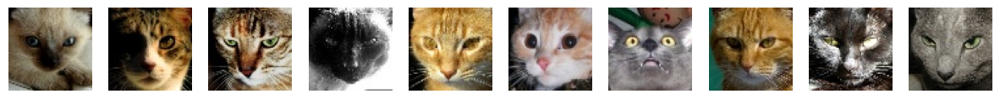

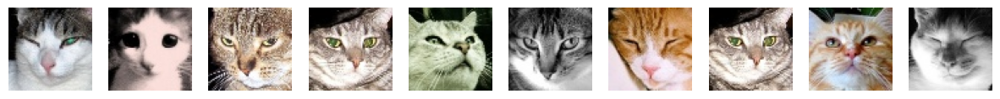

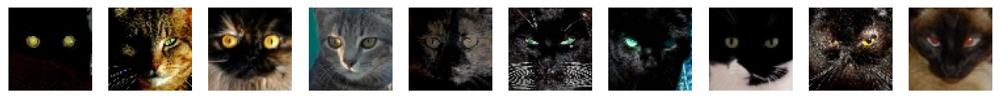

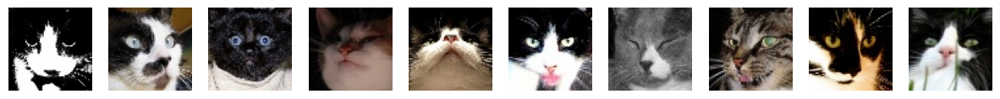

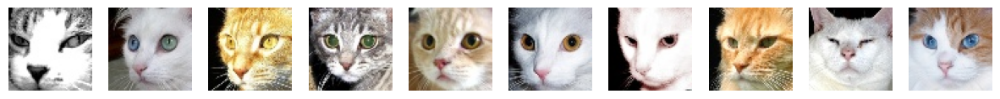

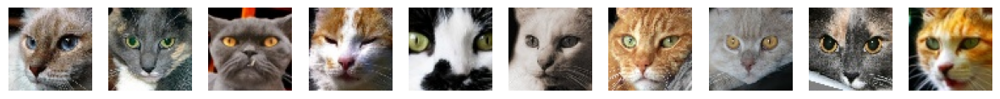

In [110]:
for cluster in np.unique(kmeans_pred):
    cluster_points = cats_projection_2d[kmeans_pred == cluster]
    cluster_cats = cats[kmeans_pred == cluster]

    # Находим центр кластера
    cluster_center = cluster_points.mean(axis=0)
    # Считаем расстояния до центра от каждой точки кластера
    distances = np.linalg.norm(cluster_center - cluster_points, axis=1)
    # Сортируем расстояния и берем индексы в порядке возрастания расстояний
    closest_idxs = np.argsort(distances)
    # Берем топ-10 уникальных ответов, соответствующих полученным индексам
    closest_images = np.unique(cluster_cats[closest_idxs], axis=0)[:10]
    plt.figure(figsize=(15, 10))
    for (i, img) in zip(range(10), closest_images):
        plt.subplot(1, 10, i+1)
        plt.imshow(img.reshape(64, 64, 3))
        plt.axis("off")


Наблюдаются ли какие-то закономерности в изображениях внутри одного кластера? Если да, то опишите отличительные черты кластеров.

Как мы видим, серьезных закономерностей нет. В отдельный кластер объединены котики потемнее, еще в один - посветлее. Также, в отдельном кластере - котики с пятнами. Ничего более существенного нет.

Подумайте, чем может быть плох такой подход? Какая проблема могла возникнуть и возникла ли? Обратите внимание на проведенное ранее исследование.

Подход плох тем, что при векторном представлении никак не учитываются связи между близко расположенными пикселями. Проблема с большой размерность никуда не делась. Здесь же размерность просто огромная.

#### 3. PCA + кластеризация

Попробуем уменьшить размерность перед кластеризацией с помощью PCA, спроектировав изображения на первые несколько главных компонент 

**Примечание.** Не стоит брать больше 100 главных компонент

Сделайте кластеризацию:

In [111]:
%%time
pca = PCA(n_components=60)
cats_projection = pca.fit_transform(cats.astype(np.float32))

kmeans = KMeans(n_clusters=6, n_init="auto", random_state=42)
kmeans.fit(cats_projection)

CPU times: user 18.6 s, sys: 4.18 s, total: 22.8 s
Wall time: 6.11 s


KMeans(n_clusters=6, n_init='auto', random_state=42)

Визуализируйте полученные кластера:

/opt/conda/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



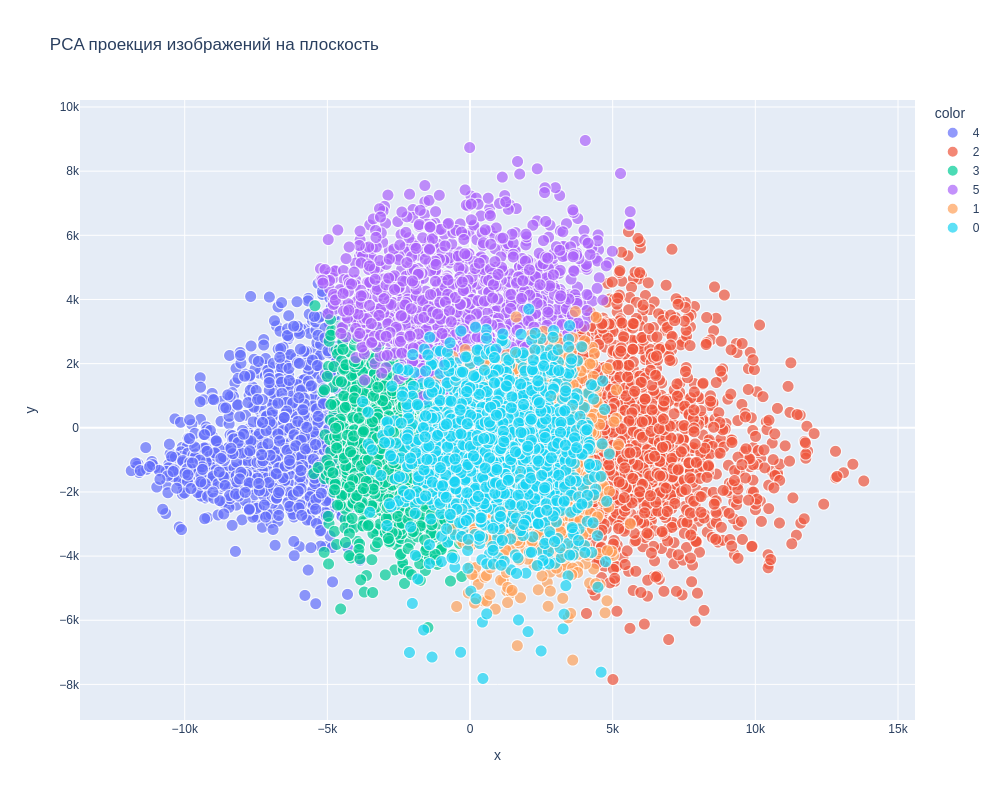

In [112]:
kmeans_pred = kmeans.predict(cats_projection)
pca = PCA(n_components=2)
cats_projection_2d = pca.fit_transform(cats_projection.astype(np.float32))
visualize_images_clusterisation(cats_projection, cats_projection_2d, kmeans_pred)

Нарисуйте по 5-10 типичных изображений для новых кластеров

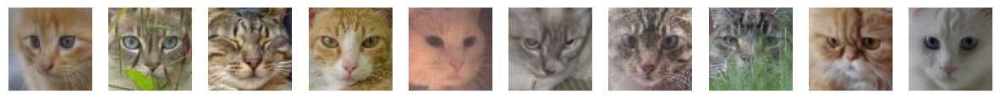

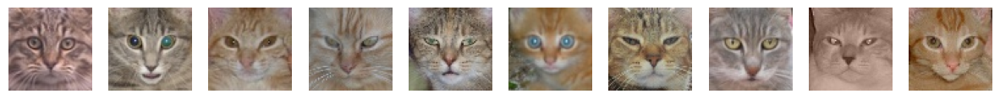

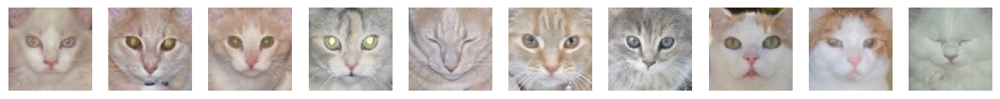

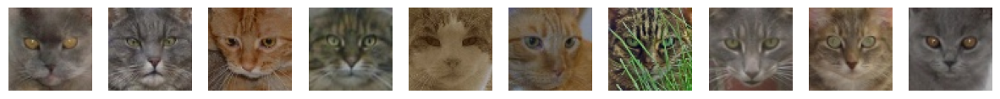

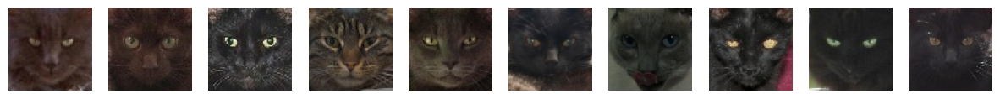

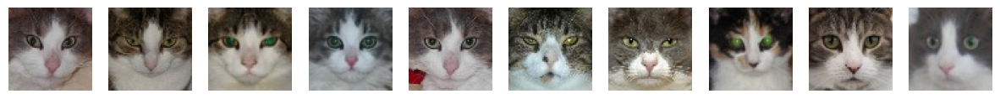

In [113]:
for cluster in np.unique(kmeans_pred):
    cluster_points = cats_projection[kmeans_pred == cluster]
    cluster_cats = cats[kmeans_pred == cluster]

    # Находим центр кластера
    cluster_center = cluster_points.mean(axis=0)
    # Считаем расстояния до центра от каждой точки кластера
    distances = np.linalg.norm(cluster_center - cluster_points, axis=1)
    # Сортируем расстояния и берем индексы в порядке возрастания расстояний
    closest_idxs = np.argsort(distances)
    # Берем топ-10 уникальных ответов, соответствующих полученным индексам
    closest_images = cluster_cats[closest_idxs][:10]
    plt.figure(figsize=(15, 10))
    for (i, img) in zip(range(10), closest_images):
        plt.subplot(1, 10, i+1)
        plt.imshow(img.reshape(64, 64, 3))
        plt.axis("off")

Опишите отличительные черты кластеров:

1. Под углом к камере / с особой мимикой
2. Светлые, полосатые
3. Совсем светлые
4. Полосатые
5. Темные, глаза светятся
6. Имеются пятна

Сильно ли они отличаются от предыдущего способа?

Отличия определенно есть. У каждого кластера есть отличительные черты. Но например, не все коты кластера обладают этими чертами. Также, видно, что в четвертой строке (четвертом кластере) есть котик, спрятавшийся за траву, и модель спутала это с узором шерсти. Тем не менее, и сам кот имеет полосатую шерсть, так что нельзя точно сказать, ошибка ли это модели и просто совпадание или модель намеренно отнесла кота к нужному кластеру.

#### 4. Нейросетевые эмбеддинги + кластеризация

Попробуем применить к изображениям такой же подход, как с текстами. То есть возьмем хорошую уже обученную нейросеть, получим с ее помощью эмбеддинги изображений и будем дулеть кластеризацию этих эмбеддингов.

Выберите на <a target="_blank" href="https://huggingface.co/models">huggingface</a> модель для получения эмбеддингов изображений.

**Примечания**
- Нам нужны `CV` модели для задачи извлечения признаков (в фильтрах huggingface называются `Image Feature Extraction`).
- Не выбирайте слишком тяжелые модели (с суффиксами `-huge`, `-giant`, `-large` и прочим), нам это ни к чему, так как картинки маленькие и простые. К тому же это замедлит предсказание эмбеддингов.
- Обычно в карточке модели есть пример применения, который можно скопировать и как в семинаре в цикле применить ко всем батчам изображениям.
- Некоторые модели могут возвращать не эмбеддинг размерности `(D,)`, а матрицу признаков размерности `(n, D)`, в этому случае надо применить average-pooling, усреднив по предпоследней оси.

Загрузите модель, примените к одному тестовому изображению кота и посмотрите на размерность полученного тензора

In [5]:
from transformers import ViTImageProcessor, ViTModel
from PIL import Image
import requests

import torch
from torch.utils.data import DataLoader, TensorDataset

# url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
# image = Image.open(requests.get(url, stream=True).raw)

In [13]:
example_image = cats[0].reshape(64, 64, 3)

# Загрузка и тестовое применение модели
processor = ViTImageProcessor.from_pretrained('google/vit-base-patch16-224-in21k')
model = ViTModel.from_pretrained('google/vit-base-patch16-224-in21k')
inputs = processor(images=example_image, return_tensors="pt")

outputs = model(**inputs)
last_hidden_states = outputs.last_hidden_state
# pooler_output = outputs.pooler_output.detach().numpy()
last_hidden_states.shape

torch.Size([1, 197, 768])

Теперь примените загруженную модель ко всем картинкам

In [14]:
# images = cats.reshape(-1, 64, 64, 3)
# inputs = processor(images=images, return_tensors="pt").to("cuda")
# outputs = model(**inputs).to("cuda")
# pooler_output = outputs.pooler_output.detach().to("cpu").numpy()
# pooler_output.shape

images = cats.reshape(-1, 64, 64, 3)
cats_tensor = torch.tensor(images).to("cuda")

dataset = TensorDataset(cats_tensor)
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

model = model.to("cuda")

pooler_outputs = []

for batch in dataloader:
    imgs = batch[0].reshape(-1, 64, 64, 3)
    inputs = processor(images=imgs, return_tensors="pt")
    inputs = inputs.to("cuda")
    outputs = model(**inputs)
#     pooler_outputs.append(outputs.pooler_output.detach().to("cpu").numpy())
    pooler_outputs.append(torch.mean(outputs.last_hidden_state, axis=-2).detach().to("cpu").numpy())

pooler_output = np.concatenate(pooler_outputs, axis=0)
pooler_output.shape

(9303, 768)

Сделайте кластеризацию полученных эмбеддингов

In [22]:
%%time

pca = PCA(n_components=60)
cats_projs = pca.fit_transform(pooler_output.astype(np.float32))

kmeans = KMeans(n_clusters=6, n_init="auto", random_state=42)
kmeans.fit(cats_projs)

CPU times: user 1.97 s, sys: 1.07 s, total: 3.04 s
Wall time: 781 ms


KMeans(n_clusters=6, n_init='auto', random_state=42)

Визуализируйте полученные кластера:

/opt/conda/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



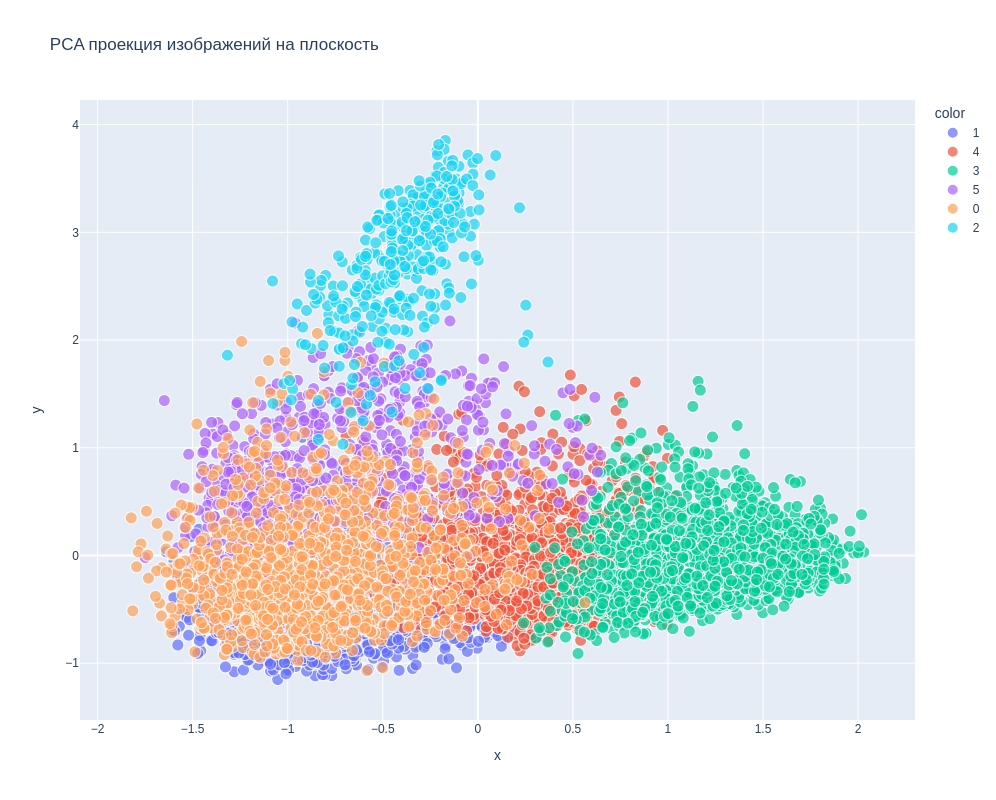

In [23]:
kmeans_pred = kmeans.predict(cats_projs)
pca = PCA(n_components=2)
projection_2d = pca.fit_transform(cats_projs.astype(np.float32))
visualize_images_clusterisation(cats_projs, projection_2d, kmeans_pred)

Нарисуйте по 5-10 типичных изображений для новых кластеров

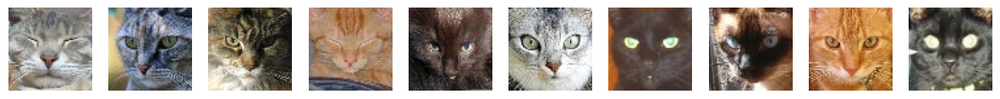

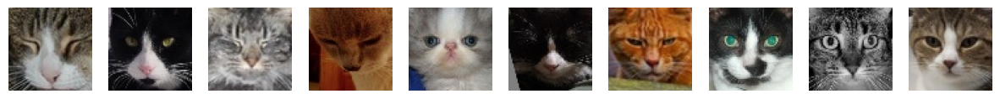

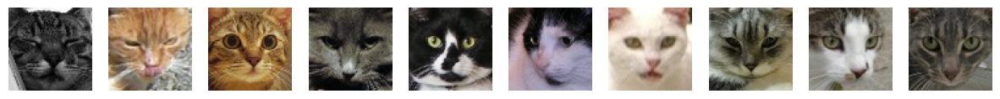

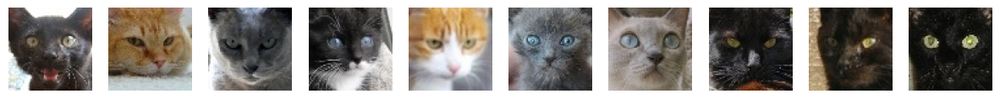

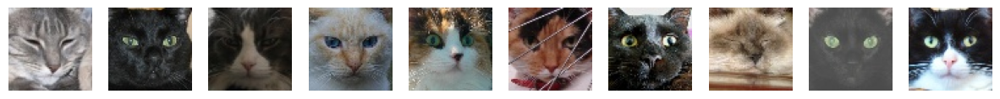

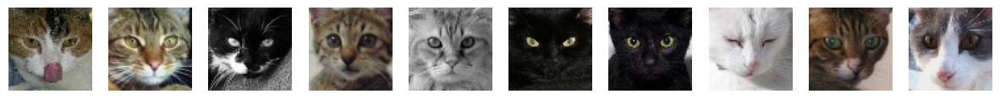

In [24]:
for cluster in np.unique(kmeans_pred):
    cluster_points = cats_projs[kmeans_pred == cluster]
    cluster_cats = cats[kmeans_pred == cluster]

    # Находим центр кластера
    cluster_center = cluster_points.mean(axis=0)
    # Считаем расстояния до центра от каждой точки кластера
    distances = np.linalg.norm(cluster_center - cluster_points, axis=1)
    # Сортируем расстояния и берем индексы в порядке возрастания расстояний
    closest_idxs = np.argsort(distances)[:10]
    # Берем топ-10 уникальных ответов, соответствующих полученным индексам
    closest_images = cluster_cats[closest_idxs]
    plt.figure(figsize=(15, 10))
    for (i, img) in zip(range(10), closest_images):
        plt.subplot(1, 10, i+1)
        plt.imshow(img.reshape(64, 64, 3))
        plt.axis("off")

Опишите отличительные черты кластеров:

Как мы видим, серьезных успехов достичь не удалось. Почему? Я пока не выяснил. Модель обучилась вроде как непохо, судя по графикам. Возможно, ошибка во время визуализации типичных предстваителей (т.е. модель работает хорошо, просто мы этого не видим:)). Тем не менее, найти проблему я не успел, постараюс сделать это на дорешке.

Чем отличаются кластеры, полученные этим способом от первых двух?

Хотел как лучше получилось как всегда.

#### 5. Выводы
Сделайте выводы: 

Как мы убедились, проблеме проклятия большой размерности подвержены и котики. Тем не менее, даже ничего не предпринимая, кое-как кластеризовать котиков получилось. Чуть лучше себя показала кластеризация тем же методом KMeans с предварительным применением PCA - более конкретные отличитеные черты у кластеров. Тем не менее, и во втором случае есть проблемы - не все котики в кластере обладают этими чертами.
Что же касается использования уже обученной модели, то успехов достичь у меня не вышло, о чем я писал чуть выше.